In [1]:
import pandas as pd
from pathlib import Path
import glob
from PIL import Image, ImageDraw
import torchvision.transforms.functional as TVF
import torch.nn as nn
from torchvision.utils import draw_segmentation_masks
import matplotlib.pyplot as plt
import torchvision
from tqdm.notebook import tqdm

In [2]:
torchvision.__version__

'0.11.1+cpu'

In [3]:
import sys
sys.path.insert(0, "../")

In [4]:
from src.model.deeplabv3 import TrashDetector
from src.data.dataset import TrashDataset
from torch.utils.data import DataLoader
from pytorch_lightning.loggers import TensorBoardLogger
from pytorch_lightning.callbacks import ModelCheckpoint

In [5]:
from torchvision import transforms
import torch
import pytorch_lightning as pl
from pathlib import Path
import numpy as np
from copy import deepcopy

In [6]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [7]:
dataset_path = Path("../data/raw/")

In [8]:
data = pd.read_csv(dataset_path / 'test' / '-predict.csv', sep=",")

In [9]:
data.loc[0, 'Unnamed: 0']

0

In [10]:
data.head()

,Unnamed: 0,INPUT:image
0,0,https://storage.yandexcloud.net/garbage-images...
1,2,https://storage.yandexcloud.net/garbage-images...
2,4,https://storage.yandexcloud.net/garbage-images...
3,6,https://storage.yandexcloud.net/garbage-images...
4,9,https://storage.yandexcloud.net/garbage-images...


In [11]:
dict_id = {}

In [12]:
for i in range(0, len(data)):
    id_ = data.loc[i, 'Unnamed: 0']
    img_ = data.loc[i, 'INPUT:image']
    name_ = img_.split('/')[-1]
    #print(name_)
    dict_id[name_] = id_

In [13]:
all_images = glob.glob(str(dataset_path) + '/test/test/*.jpg')

In [14]:
transform = preprocess = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((512, 512)),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [15]:
path = Path('/home/renesat/0. PARA/1. Projects/Ecodrone/NN/logs/DeepLabV3_3/version_6/checkpoints/deeplabv3-epoch=07-val_loss=0.00e+00.ckpt')

model = TrashDetector.load_from_checkpoint(path)
model = model.to(device)
model = model.eval()

In [16]:
def rle_encode(img):
    '''
    img: numpy array, 1 - mask, 0 - background
    Returns run length as string formated
    '''
    pixels = img.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)

In [12]:
img_path = Path('/home/user/Projects/test.jpg')

  0%|          | 0/1935 [00:00<?, ?it/s]

0
torch.Size([3, 512, 512])


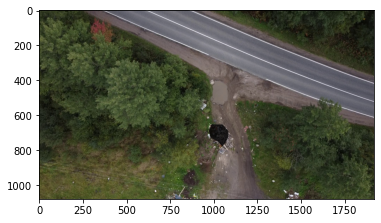

2
torch.Size([3, 512, 512])


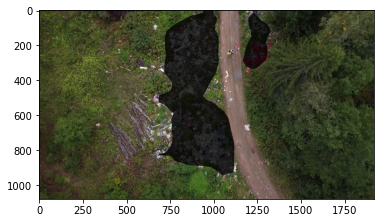

4
torch.Size([3, 512, 512])


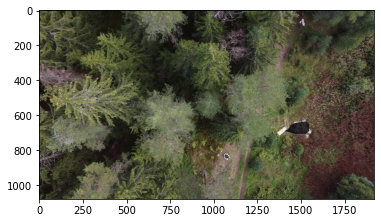

6
torch.Size([3, 512, 512])


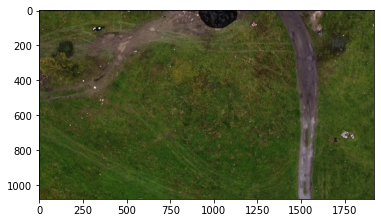

9
torch.Size([3, 512, 512])


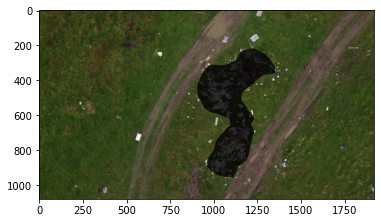

11
torch.Size([3, 512, 512])


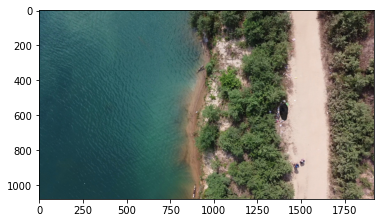

12
torch.Size([3, 512, 512])


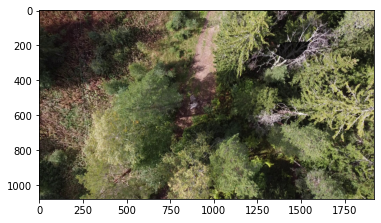

13
torch.Size([3, 512, 512])


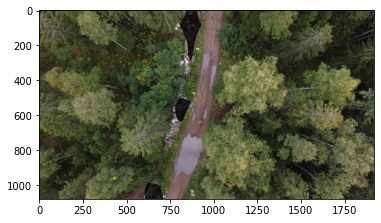

14
torch.Size([3, 512, 512])


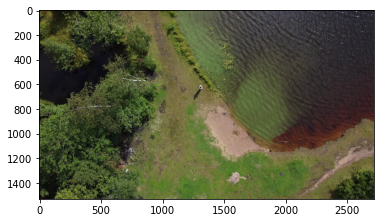

15
torch.Size([3, 512, 512])


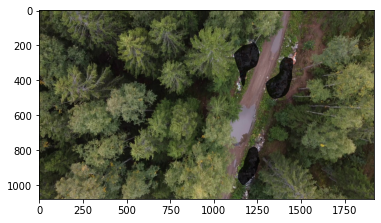

16
torch.Size([3, 512, 512])


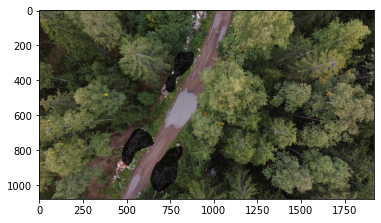

17
torch.Size([3, 512, 512])


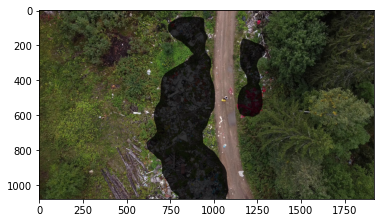

18
torch.Size([3, 512, 512])


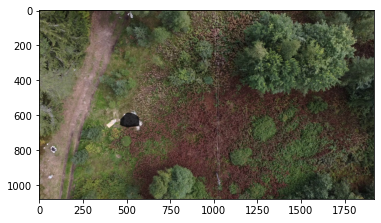

19
torch.Size([3, 512, 512])


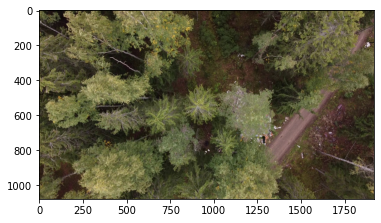

20
torch.Size([3, 512, 512])


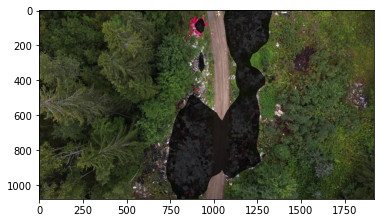

22
torch.Size([3, 512, 512])


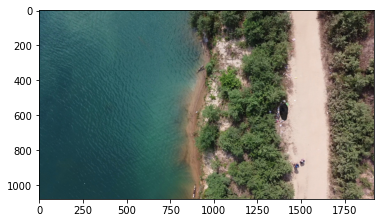

23
torch.Size([3, 512, 512])


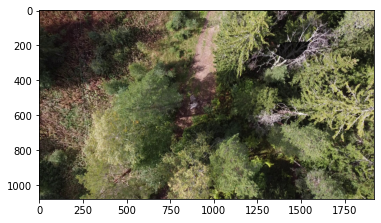

24
torch.Size([3, 512, 512])


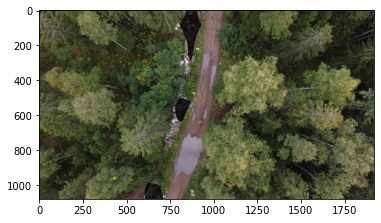

25
torch.Size([3, 512, 512])


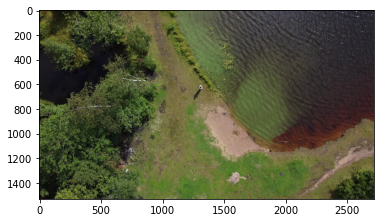

26
torch.Size([3, 512, 512])


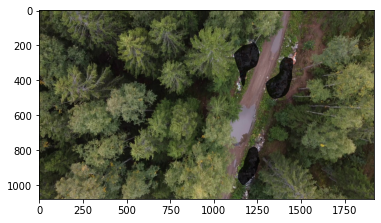

27
torch.Size([3, 512, 512])


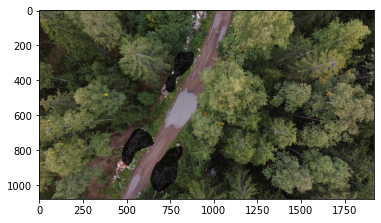

28
torch.Size([3, 512, 512])


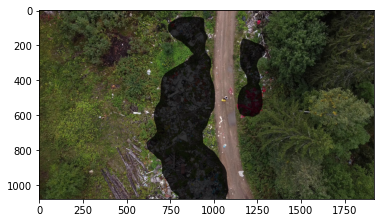

29
torch.Size([3, 512, 512])


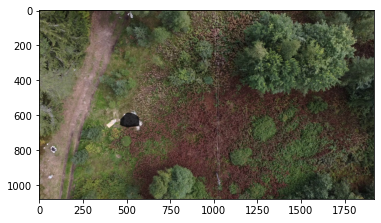

30
torch.Size([3, 512, 512])


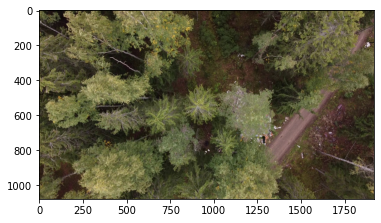

31
torch.Size([3, 512, 512])


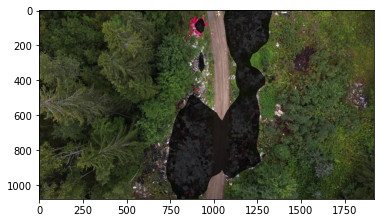

33
torch.Size([3, 512, 512])


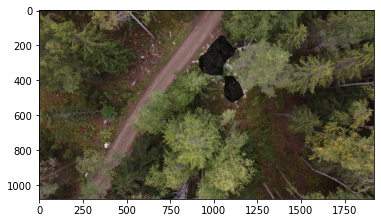

34
torch.Size([3, 512, 512])


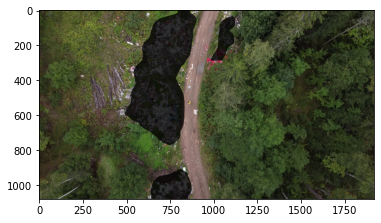

36
torch.Size([3, 512, 512])


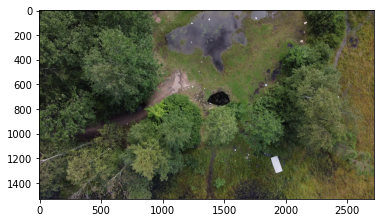

37
torch.Size([3, 512, 512])


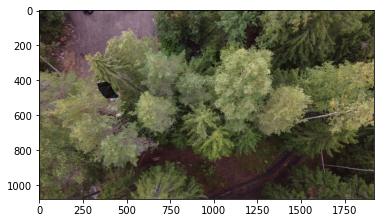

38
torch.Size([3, 512, 512])


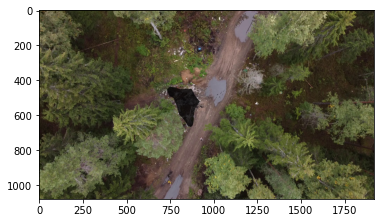

39
torch.Size([3, 512, 512])


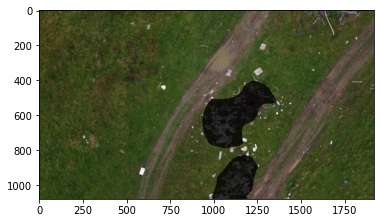

40
torch.Size([3, 512, 512])


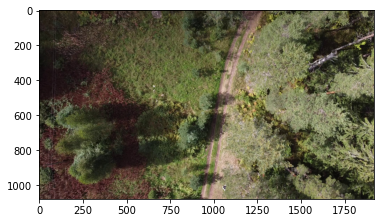

41
torch.Size([3, 512, 512])


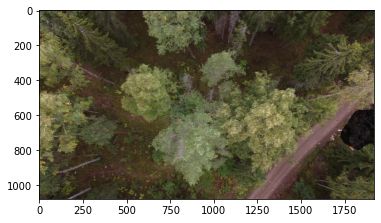

42
torch.Size([3, 512, 512])


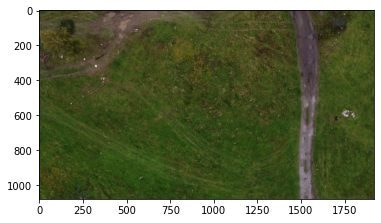

44
torch.Size([3, 512, 512])


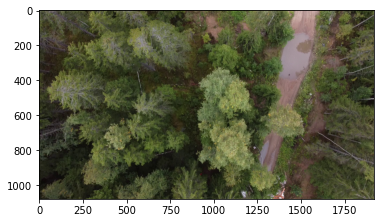

47
torch.Size([3, 512, 512])


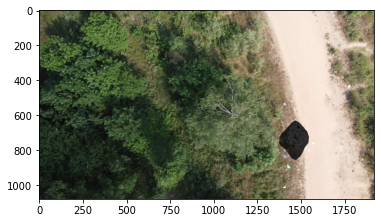

48
torch.Size([3, 512, 512])


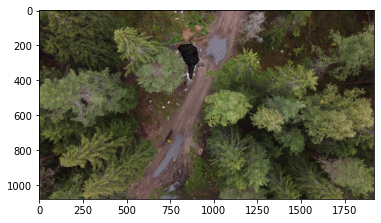

49
torch.Size([3, 512, 512])


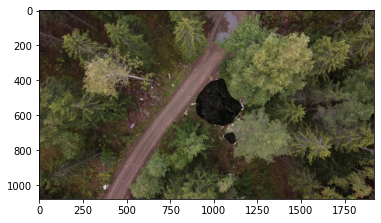

50
torch.Size([3, 512, 512])


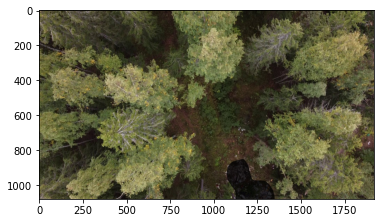

51
torch.Size([3, 512, 512])


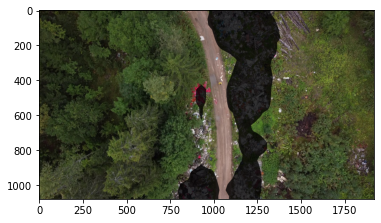

52
torch.Size([3, 512, 512])


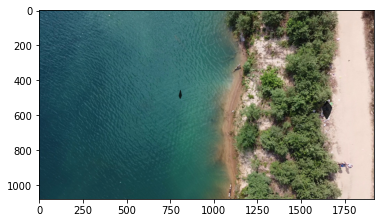

55
torch.Size([3, 512, 512])


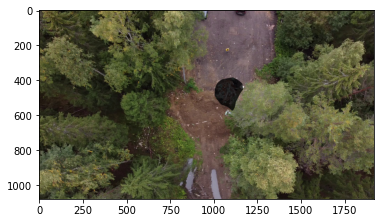

56
torch.Size([3, 512, 512])


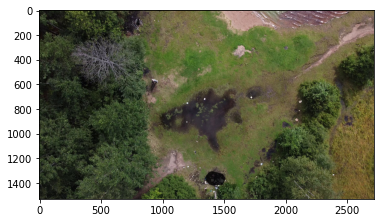

57
torch.Size([3, 512, 512])


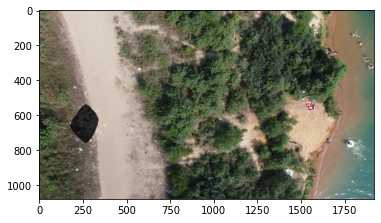

59
torch.Size([3, 512, 512])


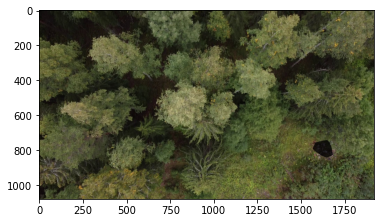

60
torch.Size([3, 512, 512])


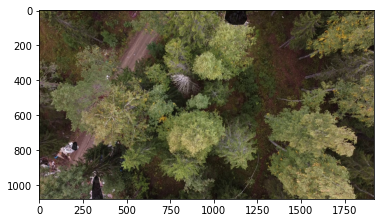

61
torch.Size([3, 512, 512])


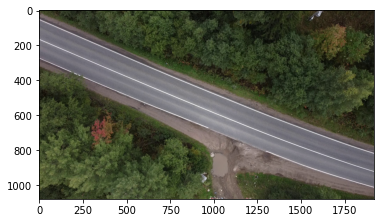

63
torch.Size([3, 512, 512])


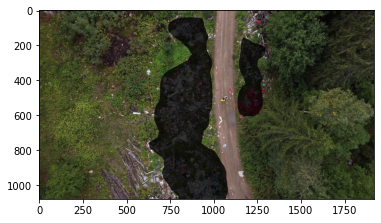

66
torch.Size([3, 512, 512])


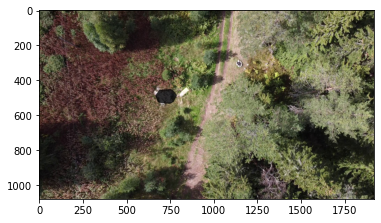

67
torch.Size([3, 512, 512])


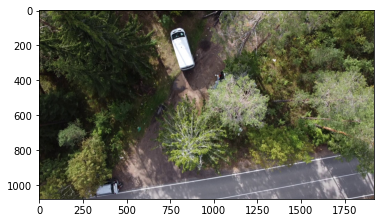

68
torch.Size([3, 512, 512])


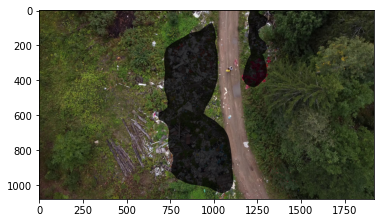

69
torch.Size([3, 512, 512])


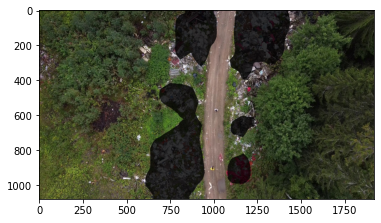

70
torch.Size([3, 512, 512])


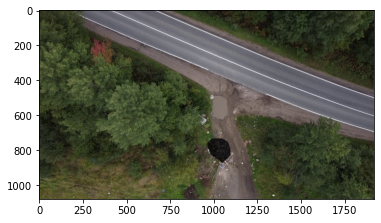

71
torch.Size([3, 512, 512])


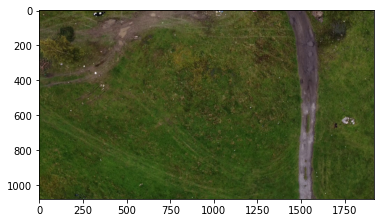

72
torch.Size([3, 512, 512])


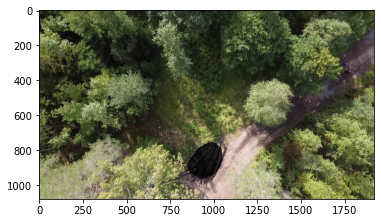

73
torch.Size([3, 512, 512])


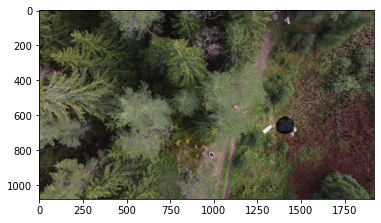

74
torch.Size([3, 512, 512])


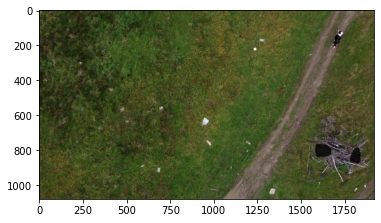

75
torch.Size([3, 512, 512])


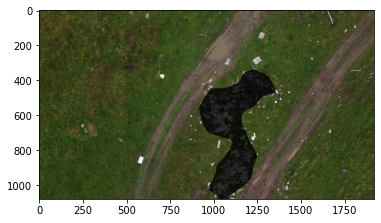

77
torch.Size([3, 512, 512])


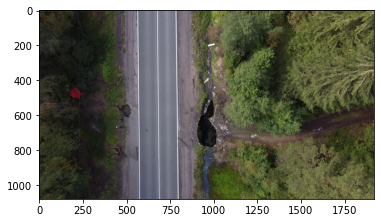

78
torch.Size([3, 512, 512])


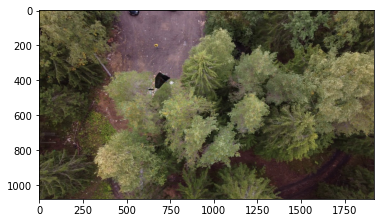

79
torch.Size([3, 512, 512])


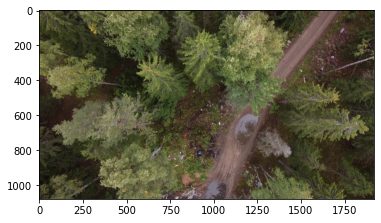

80
torch.Size([3, 512, 512])


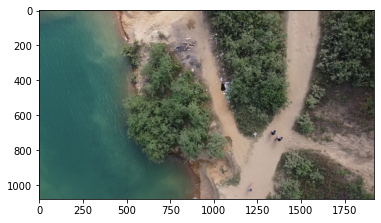

81
torch.Size([3, 512, 512])


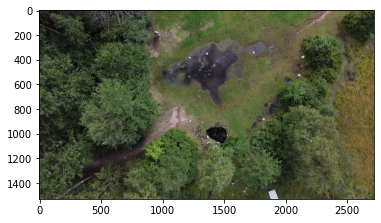

82
torch.Size([3, 512, 512])


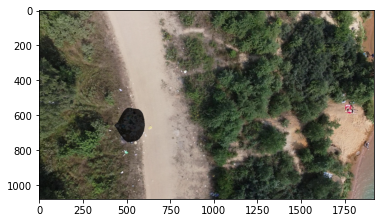

83
torch.Size([3, 512, 512])


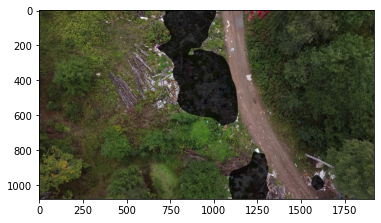

84
torch.Size([3, 512, 512])


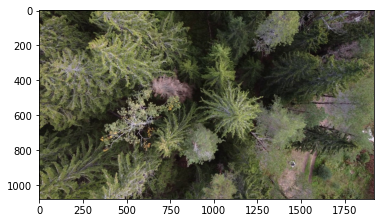

85
torch.Size([3, 512, 512])


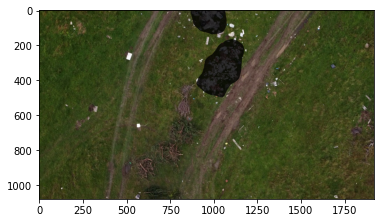

86
torch.Size([3, 512, 512])


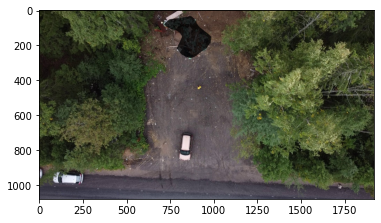

88
torch.Size([3, 512, 512])


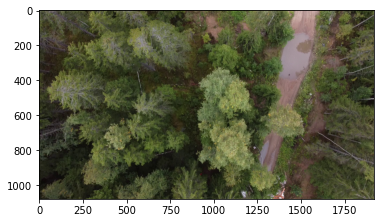

89
torch.Size([3, 512, 512])


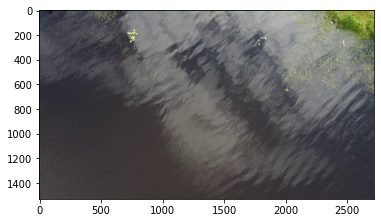

90
torch.Size([3, 512, 512])


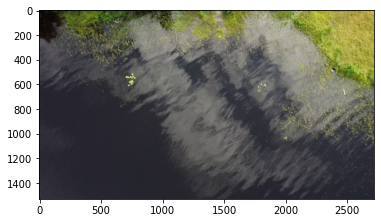

91
torch.Size([3, 512, 512])


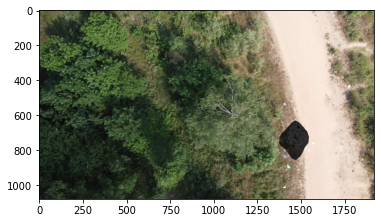

92
torch.Size([3, 512, 512])


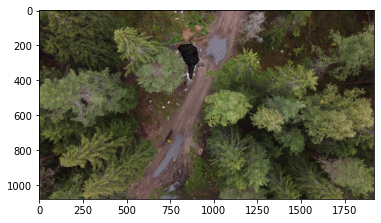

93
torch.Size([3, 512, 512])


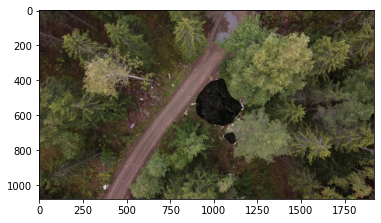

94
torch.Size([3, 512, 512])


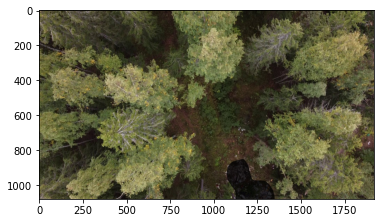

95
torch.Size([3, 512, 512])


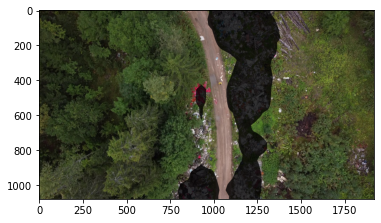

96
torch.Size([3, 512, 512])


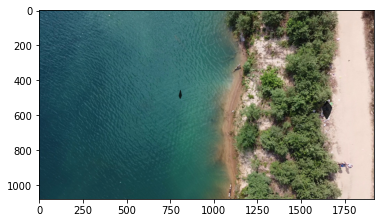

97
torch.Size([3, 512, 512])


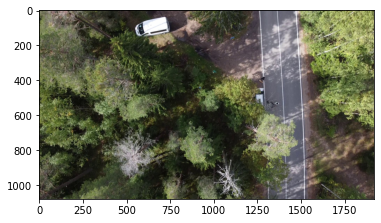

99
torch.Size([3, 512, 512])


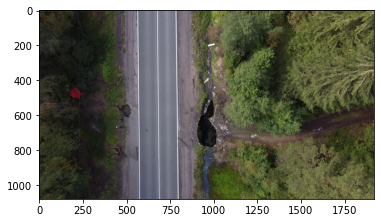

100
torch.Size([3, 512, 512])


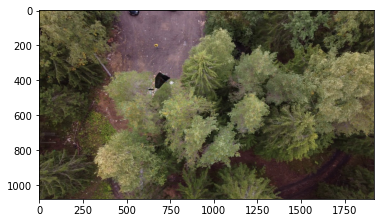

101
torch.Size([3, 512, 512])


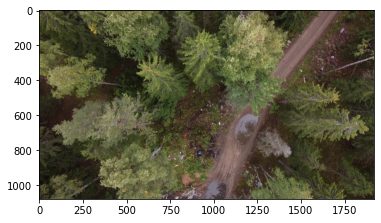

102
torch.Size([3, 512, 512])


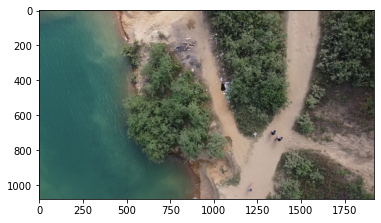

103
torch.Size([3, 512, 512])


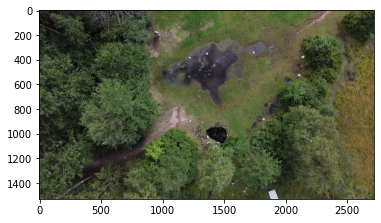

104
torch.Size([3, 512, 512])


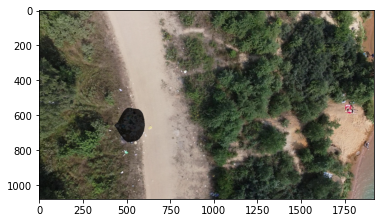

105
torch.Size([3, 512, 512])


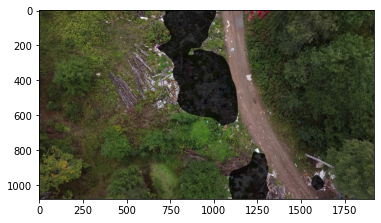

107
torch.Size([3, 512, 512])


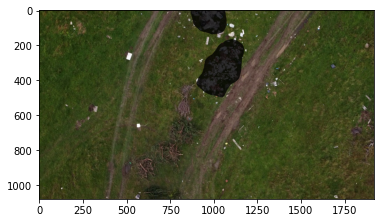

108
torch.Size([3, 512, 512])


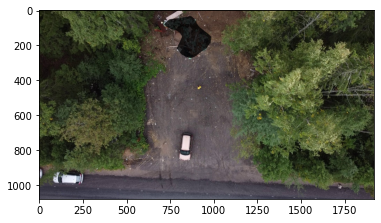

110
torch.Size([3, 512, 512])


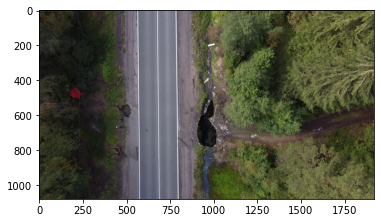

111
torch.Size([3, 512, 512])


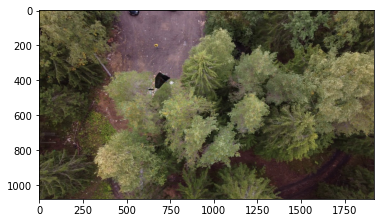

112
torch.Size([3, 512, 512])


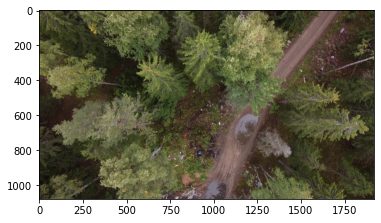

113
torch.Size([3, 512, 512])


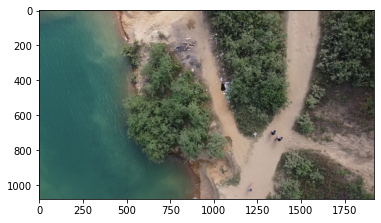

114
torch.Size([3, 512, 512])


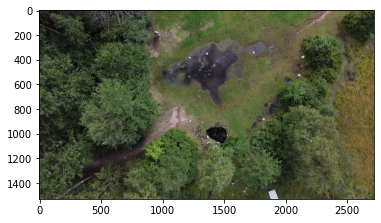

115
torch.Size([3, 512, 512])


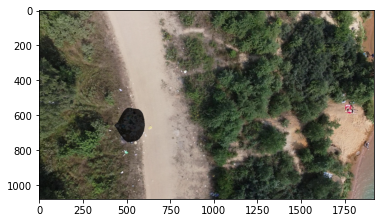

116
torch.Size([3, 512, 512])


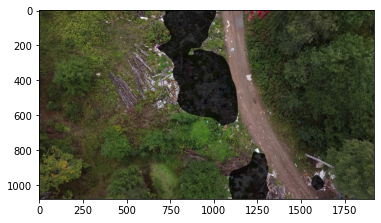

117
torch.Size([3, 512, 512])


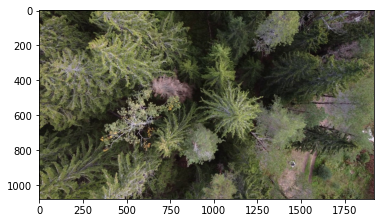

118
torch.Size([3, 512, 512])


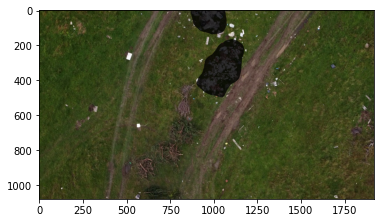

119
torch.Size([3, 512, 512])


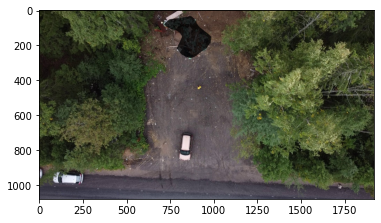

122
torch.Size([3, 512, 512])


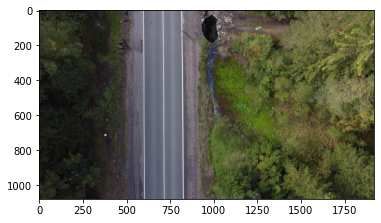

123
torch.Size([3, 512, 512])


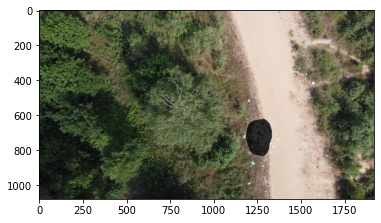

124
torch.Size([3, 512, 512])


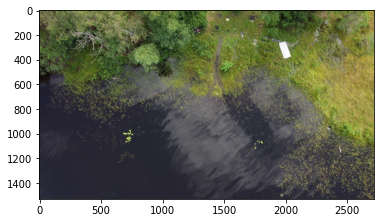

125
torch.Size([3, 512, 512])


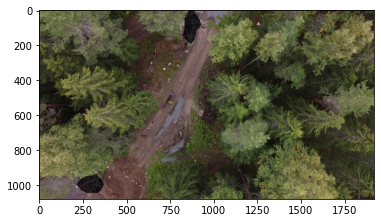

126
torch.Size([3, 512, 512])


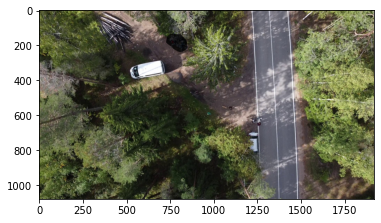

128
torch.Size([3, 512, 512])


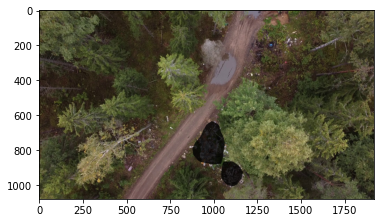

129
torch.Size([3, 512, 512])


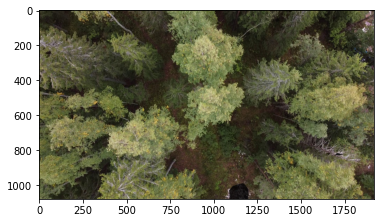

130
torch.Size([3, 512, 512])


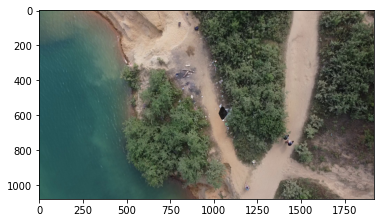

132
torch.Size([3, 512, 512])


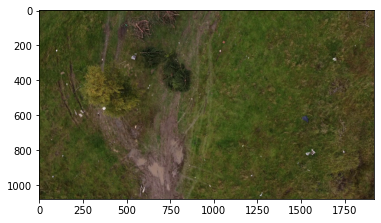

134
torch.Size([3, 512, 512])


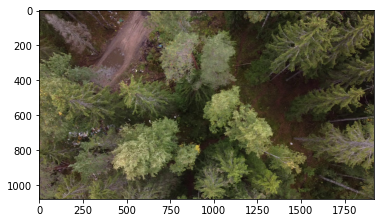

135
torch.Size([3, 512, 512])


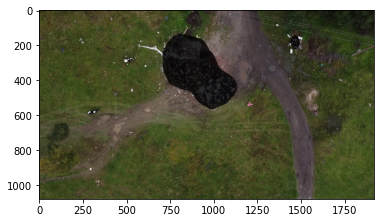

136
torch.Size([3, 512, 512])


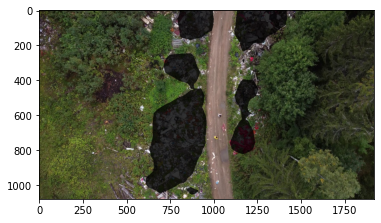

137
torch.Size([3, 512, 512])


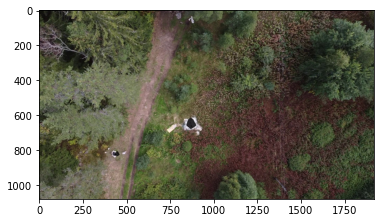

139
torch.Size([3, 512, 512])


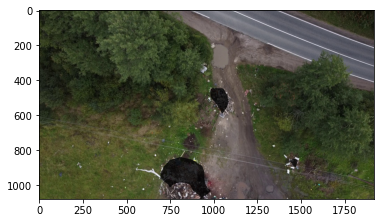

140
torch.Size([3, 512, 512])


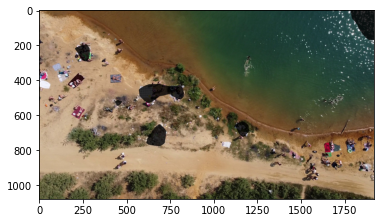

141
torch.Size([3, 512, 512])


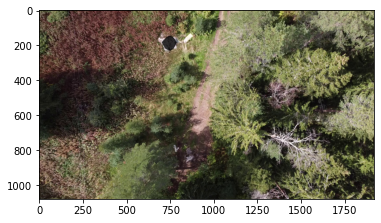

143
torch.Size([3, 512, 512])


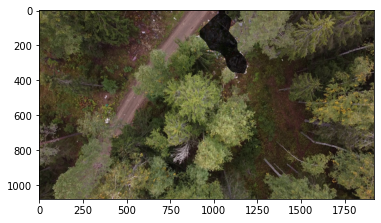

146
torch.Size([3, 512, 512])


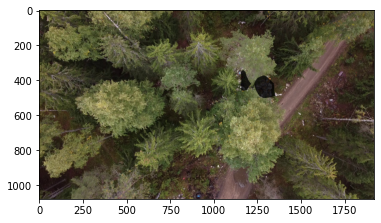

147
torch.Size([3, 512, 512])


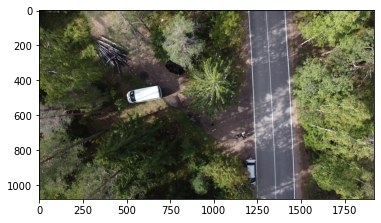

149
torch.Size([3, 512, 512])


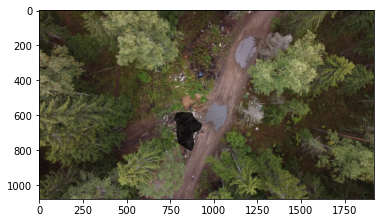

150
torch.Size([3, 512, 512])


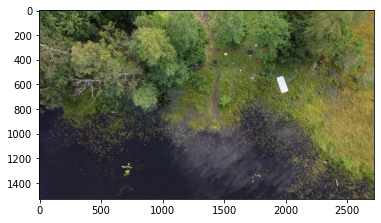

151
torch.Size([3, 512, 512])


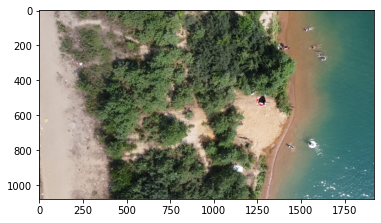

152
torch.Size([3, 512, 512])


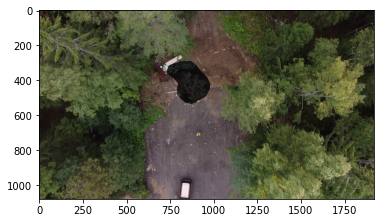

154
torch.Size([3, 512, 512])


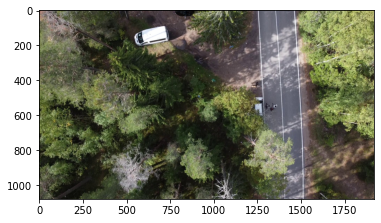

157
torch.Size([3, 512, 512])


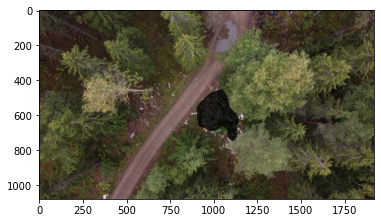

158
torch.Size([3, 512, 512])


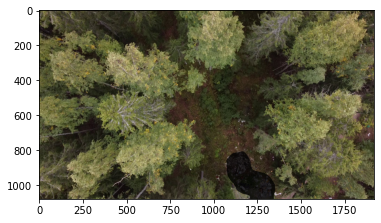

159
torch.Size([3, 512, 512])


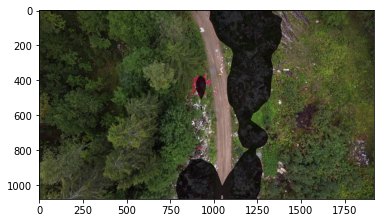

160
torch.Size([3, 512, 512])


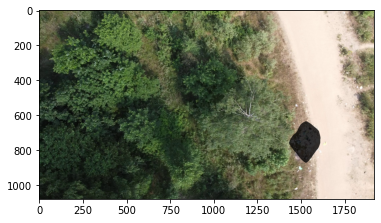

In [ ]:
result_dict = {}
for i in tqdm(range(0, len(data))):
    img_ = data.loc[i, 'INPUT:image']
    id_ = data.loc[i, 'Unnamed: 0']
    print(id_)
    name_ = img_.split('/')[-1]
    image_path = str(dataset_path) + '/test/test/' + name_
    image = Image.open(image_path)
    #print(image.size)
    image_t = transform(image)
    print(image_t.shape)
    #print(image_t.shape)
    output = model(image_t.unsqueeze(0).to(device))["out"]
    output = nn.Sigmoid()(output).squeeze(1)
    output = output.to('cpu')
    
    #print(output)
    resized_mask = transforms.Resize((image.size[1], image.size[0]))(output[0].unsqueeze(0)).squeeze(0)
    out_result = (resized_mask > 0.5).bool()
    
    plt.imshow(TVF.to_pil_image(draw_segmentation_masks(
                   (TVF.to_tensor(image) * 255).type(torch.ByteTensor),
                   out_result,
                   alpha=0.8,
               )))
    plt.show()
    
    #print(out_result.detach().numpy())
    rle = rle_encode(out_result.detach().numpy())
    #print(rle)
    result_dict[id_] = rle
    #break

In [ ]:
len(result_dict)

In [78]:
image.unsqueeze(1).shape

torch.Size([3, 1, 512, 1024])

In [15]:
result = []
for k,v in result_dict.items():
    result.append({
        "Id": k,
        "Predicted": v,
    })

In [16]:
pd.DataFrame(result)

,Id,Predicted
0,0,1249036 6 1250929 7 1250941 9 1250954 12 12528...
1,2,20429 5 22347 9 24266 10 26186 10 28106 10 300...
2,4,97511 3 99430 6 101350 7 103270 7 105180 4 105...
3,6,934 193 1133 4 2852 207 4767 218 6674 234 8582...
4,9,460098 1 462010 21 463928 27 465847 32 467766 ...
...,...,...
1930,2405,21798 12 24514 19 27231 23 29950 24 32669 25 3...
1931,2406,152668 1 154586 4 156506 5 158425 8 160345 9 1...
1932,2407,10519 21 12437 25 14356 27 16274 32 18192 36 2...
1933,2408,8961 55 10871 72 12789 75 14706 79 16625 81 18...


In [17]:
len(result)

1935

In [20]:
pd.DataFrame(result).to_csv("result_2.csv", index=None, quoting = csv.QUOTE_NONNUMERIC)

In [19]:
 import csv